In [1]:
import squidpy as sq
import scanpy as sc
import scipy as scp
import numpy as np 
import pandas as pd
import matplotlib.pyplot as pl
import scanorama
from pathlib import Path
import sklearn

In [2]:
sc.logging.print_versions()
sc.set_figure_params(facecolor="white", figsize=(8, 8))
sc.settings.verbosity = 3

-----
anndata     0.10.5.post1
scanpy      1.9.8
-----
OpenGL                      3.1.7
PIL                         9.4.0
PyQt5                       NA
annoy                       NA
appdirs                     1.4.4
appnope                     0.1.3
arrow                       1.2.3
asciitree                   NA
asttokens                   NA
attr                        22.2.0
babel                       2.14.0
backcall                    0.2.0
cachey                      0.2.1
certifi                     2022.12.07
cffi                        1.15.1
charset_normalizer          3.1.0
cloudpickle                 3.0.0
comm                        0.1.2
cycler                      0.10.0
cython_runtime              NA
dask                        2024.2.1
dask_image                  2023.08.1
datashader                  0.16.0
datatree                    0.0.14
dateutil                    2.8.2
debugpy                     1.6.6
decorator                   5.1.1
defusedxml              

In [3]:
sclcSC = sc.read_h5ad('hlca/sclcSingletwGenes.h5ad')
sclcVisium = sc.read_visium(path='visium/', count_file='sclcVisiumRaw.h5') #check path and set image path
sclcVisiumFiltered = sc.read_visium(path='visium/', count_file='sclcVisiumFiltered.h5', )

reading visium/sclcVisiumRaw.h5
 (0:00:01)


/Users/shivaramakrishna/Library/Python/3.9/lib/python/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/shivaramakrishna/Library/Python/3.9/lib/python/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


reading visium/sclcVisiumFiltered.h5
 (0:00:01)


/Users/shivaramakrishna/Library/Python/3.9/lib/python/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/Users/shivaramakrishna/Library/Python/3.9/lib/python/site-packages/anndata/_core/anndata.py:1908: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [4]:
sclcSC.obs.cell_type

scrBT1428_CCACGGATCGCATGGC_lambrechts    CD8-positive, alpha-beta T cell
BT1248_GGACAGGATGACCA_lambrechts         CD8-positive, alpha-beta T cell
scrBT1428_TATGCCCTCCACTGGG_lambrechts                 type II pneumocyte
scrBT1426_ATTCTACTCTGTGCAA_lambrechts                             B cell
scrBT1428_GGACGTCAGCTAACAA_lambrechts         capillary endothelial cell
                                                      ...               
scrBT1428_AGACGTTTCTATCGCC_lambrechts                alveolar macrophage
scrBT1427_CCCTCCTTCCCTTGTG_lambrechts    CD4-positive, alpha-beta T cell
scrBT1428_AACTCCCTCAGATAAG_lambrechts         capillary endothelial cell
scrBT1428_GACTACACAGATTGCT_lambrechts    CD8-positive, alpha-beta T cell
BT1247_GCCTCAACAGATCC_lambrechts              capillary endothelial cell
Name: cell_type, Length: 20561, dtype: category
Categories (38, object): ['native cell', 'mesothelial cell', 'T cell', 'mast cell', ..., 'bronchus fibroblast of lung', 'alveolar type 1 fibroblast c

In [5]:
sc.pp.calculate_qc_metrics(sclcVisiumFiltered, inplace=True)

In [6]:
sclcVisiumFiltered.var.index

Index(['SAMD11', 'NOC2L', 'KLHL17', 'PLEKHN1', 'PERM1', 'HES4', 'ISG15',
       'AGRN', 'RNF223', 'C1orf159',
       ...
       'MT-ND2', 'MT-CO2', 'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4',
       'MT-ND5', 'MT-ND6', 'MT-CYB'],
      dtype='object', length=18085)

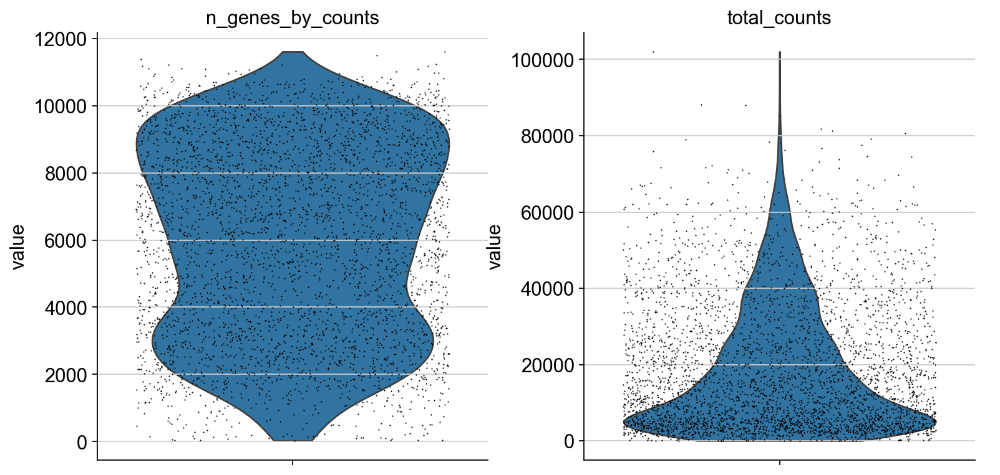

In [7]:
sclcVisiumFiltered.var_names_make_unique()
sc.pl.violin(sclcVisiumFiltered, ['n_genes_by_counts', 'total_counts'], jitter=0.4, multi_panel=True)

In [8]:
integration = scanorama.correct_scanpy([sclcSC,sclcVisiumFiltered], return_dimred=True)

Found 17510 genes among all datasets
[[0.        0.1879212]
 [0.        0.       ]]
Processing datasets (0, 1)


In [9]:
sclcSC.obsm

AxisArrays with keys: X_scanvi_emb, X_umap

In [10]:
sclcData = sc.concat(
    integration,
    label="dataset",
    keys=["single-cell", "spatial"],
    join="outer",
    uns_merge="first",
)

In [11]:
sclcData

AnnData object with n_obs × n_vars = 24419 × 17510
    obs: 'suspension_type', 'donor_id', 'is_primary_data', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'tissue_ontology_term_id', 'organism_ontology_term_id', 'sex_ontology_term_id', "3'_or_5'", 'BMI', 'age_or_mean_of_age_range', 'age_range', 'anatomical_region_ccf_score', 'ann_coarse_for_GWAS_and_modeling', 'ann_finest_level', 'ann_level_1', 'ann_level_2', 'ann_level_3', 'ann_level_4', 'ann_level_5', 'cause_of_death', 'core_or_extension', 'dataset', 'fresh_or_frozen', 'log10_total_counts', 'lung_condition', 'mixed_ancestry', 'original_ann_level_1', 'original_ann_level_2', 'original_ann_level_3', 'original_ann_level_4', 'original_ann_level_5', 'original_ann_nonharmonized', 'reannotation_type', 'sample', 'scanvi_label', 'sequencing_platform', 'smoking_status', 'study', 'subject_type', 'tissue_coarse_unharmonized', 't

In [12]:
from sklearn.metrics.pairwise import cosine_distances

distance = 1 - cosine_distances(
    sclcData[sclcData.obs.dataset == "single-cell"].obsm[
        "X_scanorama"
    ],
    sclcData[sclcData.obs.dataset == "spatial"].obsm[
        "X_scanorama"
    ],
)

In [13]:
def label_transfer(dist, labels):
    '''
    Probability based labels' assignment function
    '''
    lab = pd.get_dummies(labels).to_numpy().T
    class_prob = lab @ dist
    norm = np.linalg.norm(class_prob, 2, axis=0)
    class_prob = class_prob / norm
    class_prob = (class_prob.T - class_prob.min(1)) / class_prob.ptp(1)
    return class_prob

In [14]:
class_prob_sclc = label_transfer(distance, sclcSC.obs.cell_type) # compute labels

In [15]:
cp_sclc_df = pd.DataFrame(
    class_prob_sclc,
    columns=sorted(sclcSC.obs["cell_type"].cat.categories),
)

cp_sclc_df.index = sclcVisiumFiltered.obs.index  # transfer index

In [16]:
sclc_transfer = sclcVisiumFiltered.copy()
sclc_transfer.obs = pd.concat(
    [sclcVisiumFiltered.obs, cp_sclc_df], axis=1
)

In [17]:
sclc_transfer.var_names

Index(['SAMD11', 'NOC2L', 'KLHL17', 'PLEKHN1', 'PERM1', 'HES4', 'ISG15',
       'AGRN', 'RNF223', 'C1orf159',
       ...
       'MT-ND2', 'MT-CO2', 'MT-ATP6', 'MT-CO3', 'MT-ND3', 'MT-ND4L', 'MT-ND4',
       'MT-ND5', 'MT-ND6', 'MT-CYB'],
      dtype='object', length=18085)

In [19]:
sclc_transfer

AnnData object with n_obs × n_vars = 3858 × 18085
    obs: 'in_tissue', 'array_row', 'array_col', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'B cell', 'CD1c-positive myeloid dendritic cell', 'CD4-positive, alpha-beta T cell', 'CD8-positive, alpha-beta T cell', 'T cell', 'alveolar macrophage', 'alveolar type 1 fibroblast cell', 'alveolar type 2 fibroblast cell', 'bronchus fibroblast of lung', 'capillary endothelial cell', 'ciliated columnar cell of tracheobronchial tree', 'classical monocyte', 'club cell', 'conventional dendritic cell', 'dendritic cell', 'elicited macrophage', 'endothelial cell of lymphatic vessel', 'epithelial cell of alveolus of lung', 'epithelial cell of lower respiratory tract', 'lung macrophage', 'lung pericyte', 'mast cell', 'mesothelial cell', 'multi-ciliated epithelial cell', 'myofibroblast cell', '

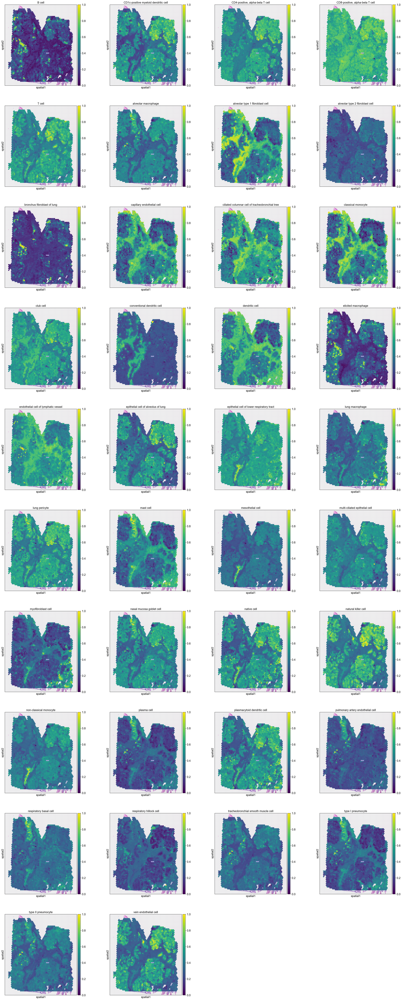

In [20]:
sc.pl.spatial(
    sclc_transfer,
    img_key="hires",
    color=['B cell', 'CD1c-positive myeloid dendritic cell', 'CD4-positive, alpha-beta T cell', 'CD8-positive, alpha-beta T cell', 'T cell', 'alveolar macrophage', 'alveolar type 1 fibroblast cell', 'alveolar type 2 fibroblast cell', 'bronchus fibroblast of lung', 'capillary endothelial cell', 'ciliated columnar cell of tracheobronchial tree', 'classical monocyte', 'club cell', 'conventional dendritic cell', 'dendritic cell', 'elicited macrophage', 'endothelial cell of lymphatic vessel', 'epithelial cell of alveolus of lung', 'epithelial cell of lower respiratory tract', 'lung macrophage', 'lung pericyte', 'mast cell', 'mesothelial cell', 'multi-ciliated epithelial cell', 'myofibroblast cell', 'nasal mucosa goblet cell', 'native cell', 'natural killer cell', 'non-classical monocyte', 'plasma cell', 'plasmacytoid dendritic cell', 'pulmonary artery endothelial cell', 'respiratory basal cell', 'respiratory hillock cell', 'tracheobronchial smooth muscle cell', 'type I pneumocyte', 'type II pneumocyte', 'vein endothelial cell'],
    size=1.5,
)